In [68]:
import pandas as pd
import plotly.graph_objs as go
import plotly.express as px
import plotly.subplots as sp
import numpy as np
import string
import matplotlib.pyplot as plt

In [69]:
#df1: our first dataset.
df1 = pd.read_csv('diabetes_binary_health_indicators_BRFSS2015.csv')

In [70]:
df1['bmi_qcut'] = pd.qcut(df1['BMI'], q=5, labels=False)

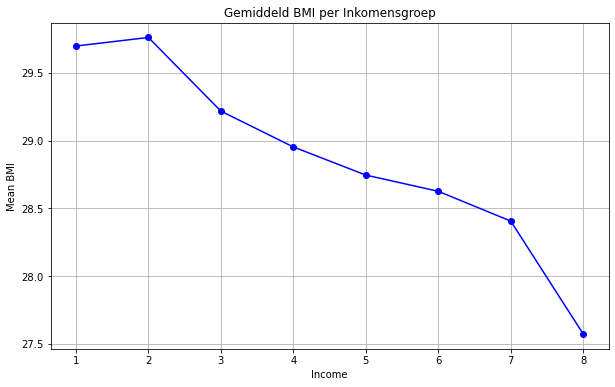

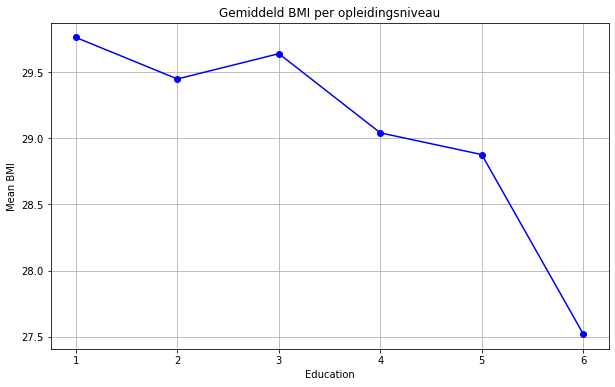

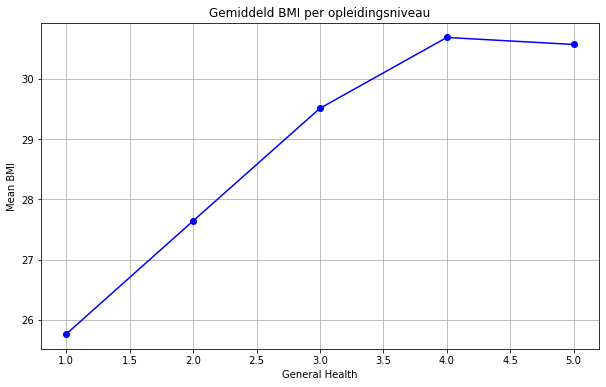

In [71]:
# graph bmi
fig = px.histogram(df1, x='BMI', title='BMI')
fig.show()

# graph income
fig = px.histogram(df1, x='Income', title='Income')
fig.show()


# bmi vs income
# Bereken het gemiddelde bmi per inkomensgroep
mean_bmi_by_income = df1.groupby('Income')['BMI'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_income.plot(kind='line', marker='o', color='blue')
plt.xlabel('Income')
plt.ylabel('Mean BMI')
plt.title('Gemiddeld BMI per Inkomensgroep')
plt.grid(True)
plt.show()


# bmi vs education
# Bereken het gemiddelde bmi per inkomensgroep
mean_bmi_by_education = df1.groupby('Education')['BMI'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_education.plot(kind='line', marker='o', color='blue')
plt.xlabel('Education')
plt.ylabel('Mean BMI')
plt.title('Gemiddeld BMI per opleidingsniveau')
plt.grid(True)
plt.show()


# bmi vs general health
mean_bmi_by_GenHlth = df1.groupby('GenHlth')['BMI'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_GenHlth.plot(kind='line', marker='o', color='blue')
plt.xlabel('General Health')
plt.ylabel('Mean BMI')
plt.title('Gemiddeld BMI per opleidingsniveau')
plt.grid(True)
plt.show()

In [72]:
cutoff=[0, 18.5, 25, 30, 999]
labels=['Underweight', 'Healthy weight', 'Overweight', 'Obese']
cut_bmi, cut_bmi_bins = pd.cut(df1['BMI'], bins=cutoff, labels=labels, retbins=True)
df1['cut_bmi'] = cut_bmi

fig2 = px.histogram(cut_bmi, x = cut_bmi)
fig2.update_layout(
    title = 'status of bmi in The US',
    xaxis = dict(title='cut_bmi'),
    width = 1072
)

bmi_counts = df1['cut_bmi'].value_counts()
# Calculate the percentage distribution
bmi_percentage = bmi_counts / len(df1) * 100

fig3 = px.pie(values=bmi_percentage, names=bmi_counts.index)
fig3.update_layout(
    title='Distribution of BMI Categories',
    width=1072
)

fig2.show()
fig3.show()

#Generative AI was used to aid the process of generating the code for fig3

In [73]:
conditions = [
    (df1['Fruits'] == 1) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 0),
    (df1['Fruits'] == 1) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 1) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 1) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 0),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 0),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 0)
]

values = [
    'Fruits+Veggies+no_hvy_alcohol',
    'Fruits+Veggies+hvy_alcohol',
    'Fruits+no_veggies+hvy_alcohol',
    'Fruits+no_veggies+no_hvy_alcohol',
    'no_fruit+Veggies+hvy_alcohol',
    'no_fruit+Veggies+no_hvy_alcohol',
    'no_fruit+no_veggies+hvy_alcohol',
    'no_fruit+no_veggies+no_hvy_alcohol'
]

# Create the new column based on the conditions and values
df1['food_consumption'] = np.select(conditions, values, default=np.nan)
df1.head(2)

,Diabetes_binary,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,...,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,bmi_qcut,cut_bmi,food_consumption
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,18.0,15.0,1.0,0.0,9.0,4.0,3.0,4,Obese,no_fruit+Veggies+hvy_alcohol
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,7.0,6.0,1.0,1,Healthy weight,no_fruit+no_veggies+no_hvy_alcohol


In [74]:
colors = {'Low': 'blue', 'Low-Medium': 'yellow', 'Medium': 'green', 'Medium-High': 'orange', 'High': 'red'}

fig5 = go.Figure(go.Parcats(
    dimensions=[
        {'label': 'BMI',
         'values': df1['cut_bmi']},
        {'label': 'Diabetes_binary',
         'values': df1['Diabetes_binary']},
        {'label': 'High_blood_pressure_binary',
         'values': df1['HighBP']},
        {'label': 'High_cholesterol_binary',
         'values': df1['HighChol']},
        {'label': 'Food_consumption',
         'values': df1['food_consumption']}
    ],
    line={'color': df1['bmi_qcut'].map(colors)},
    labelfont={'size': 18},
    tickfont={'size': 16},
    arrangement='freeform'
))


fig5.update_layout(
    title = 'Analysis of health to food consumption',
    height = 600,
    width = 1072
)
"""


# Create the Parcats trace
parcats_trace = go.Figure(go.Parcats(
    dimensions=[df1['diabetes_binary'], df1['high_bp'], df1['high_chol'], df1['food_consumption'], bmi_dim],
    line={'color': df1['bmi'].map(colors)},
    labelfont={'size': 18, 'family': 'Times'},
    tickfont={'size': 16, 'family': 'Times'},
    arrangement='freeform'
))

"""
fig5.show()
#parcast_trace.show()

In [75]:
nutritional inequality.
overlap_count_healthy2 = ((df1['Fruits'] == 1) & (df1['HvyAlcoholConsump'] == 1) & (df1['Veggies'] == 1)).sum()
overlap_count_unhealthy2 = ((df1['HighChol'] == 1) & (df1['HvyAlcoholConsump'] == 1)).sum()

column1_count = df1['Diabetes_binary'].sum()
column2_count = df1['Fruits'].sum()
column3_count = df1['Smoker'].count()
column4_count = df1['HvyAlcoholConsump'].count()
column5_count = df1['HighChol'].sum()
                      
overlap_percentage = (overlap_count / column1_count) 
percentage_smokers = (amount_of_smokers / column3_count) 
overlap_percentage_healthy = (overlap_count_healthy / column2_count) 
overlap_percentage_unhealthy = (overlap_count_unhealthy / column5_count) 

overlap_percentage2 = (overlap_count2 / column1_count) 
percentage_drinkers = (amount_of_drinkers / column4_count) 
overlap_percentage_healthy2 = (overlap_count_healthy2 / column2_count) 
overlap_percentage_unhealthy2 = (overlap_count_unhealthy2 / column5_count) 

fig = go.Figure(go.Bar(
    x = ['percentage of diabetes patients that smoke', 'percentage of healthy eaters that smoke', 'percentage of unhealthy eaters that smoke', 'percentage of all people that smoke'],
    y = [overlap_percentage, overlap_percentage_healthy, overlap_percentage_unhealthy, percentage_smokers]
))

fig.update_layout(
    yaxis=go.layout.YAxis(
       tickformat=',.0%', # show as percentage
    ),
)

fig2 = go.Figure(go.Bar(
    x = ['percentage of diabetes patients that drink heavily', 'percentage of healthy eaters that drink heavily', 'percentage of unhealthy eaters that drink heavily', 'percentage of all people that drink heavily'],
    y = [overlap_percentage2, overlap_percentage_healthy2, overlap_percentage_unhealthy2, percentage_drinkers]
))

fig2.update_layout(
    yaxis=go.layout.YAxis(
       tickformat=',.0%', # show as percentage
    ),
)

fig.show()
fig2.show()

In [76]:
overlap_count = ((df1['Diabetes_binary'] == 1) & (df1['Smoker'] == 1)).sum()
overlap_count_healthy = ((df1['Fruits'] == 1) & (df1['Smoker'] == 1) & (df1['Veggies'] == 1)).sum()
overlap_count_unhealthy = ((df1['HighChol'] == 1) & (df1['Smoker'] == 1)).sum()
amount_of_smokers = (df1['Smoker'] == 1).sum()
amount_of_nonsmokers = (df1['Smoker'] == 0).sum()

column1_count = df1['Diabetes_binary'].sum()
column2_count = df1['Fruits'].sum()
column3_count = df1['Smoker'].sum()
column5_count = df1['HighChol'].sum()
                      
overlap_percentage = (overlap_count / column1_count) * 100
percentage_smokers = (amount_of_smokers / column3_count) * 100
overlap_percentage_healthy = (overlap_count_healthy / column2_count) * 100
overlap_percentage_unhealthy = (overlap_count_unhealthy / column5_count) * 100


fig = px.pie(
    values=[overlap_percentage, 100-overlap_percentage],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of diabetes patients that smoke'
)
fig2 = px.pie(
    values = [amount_of_smokers, amount_of_nonsmokers],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of all people that smoke'
)
 
fig3 = px.pie(
    values=[overlap_percentage_healthy, 100 - overlap_percentage_healthy],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of healthy eaters that smoke'
)

fig4 = px.pie(
    values=[overlap_percentage_unhealthy, 100 - overlap_percentage_unhealthy],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of unhealthy eaters that smoke'
)


fig.show()
fig3.show()
fig4.show()
fig2.show()